<a href="https://colab.research.google.com/github/amarathe/ELEN521_labs/blob/master/Lab6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
%tensorflow_version 2.x

TensorFlow 2.x selected.


LENET with binary weights

In [0]:
%matplotlib inline

import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import *
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from IPython.display import Image
import pandas as pd
import os.path
from os import path
import glob, os
import random
from tensorflow.keras.utils import to_categorical


In [0]:
def loadmnist():
  (x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()
  return (x_train, y_train), (x_test, y_test)

(x_train, y_train), (x_test, y_test) = loadmnist()
x_train = x_train.reshape(x_train.shape[0], 784)
x_test = x_test.reshape(x_test.shape[0], 784)
y_train = to_categorical(y_train, np.max(y_train)+1).astype(np.float32)
y_test = to_categorical(y_test, np.max(y_test)+1).astype(np.float32)

x_train = x_train / 255.0
x_test  = x_test / 255.0

In [0]:
#Returns model and model before last activation (for debug)
def get_model():
  xi = Input((784,))
  x = Dense(300)(xi)
  x = Activation("relu")(x)
  x = Dense(100)(x)
  x = Activation("relu")(x)
  x = Dense(10)(x)
  x = Activation("softmax")(x)
  m = Model(inputs=xi, outputs=x)
  m.summary()
  return m




Run Without Qkeras - 96% Accuracy

In [0]:
model = get_model()
adam = Adam(lr=0.001)

print ("x_train shape:", x_train.shape)
print ("y_train shape:", y_train.shape)
model.compile(loss="categorical_crossentropy", optimizer=adam, metrics=["acc"])
history = model.fit(
    x_train, y_train,
#    steps_per_epoch=10, # number of times it executes until it declares epoch is over.
    validation_data=(x_test, y_test),
    validation_steps=10,
    epochs=20)

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 784)]             0         
_________________________________________________________________
dense (Dense)                (None, 300)               235500    
_________________________________________________________________
activation (Activation)      (None, 300)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 100)               30100     
_________________________________________________________________
activation_1 (Activation)    (None, 100)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                1010      
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0     

In [0]:
loss, acc = model.evaluate(x_test, y_test)

print ("Test accuracy:", acc)

10000/10000 [==============================] - 1s 61us/sample - loss: 0.1498 - acc: 0.9779
Test accuracy: 0.9779


In [0]:
#1st, 3rd and 5th layers are dense
for i in (0, 2, 4):
  print(model.get_weights()[i].shape)

(784, 300)
(300, 100)
(100, 10)


In [0]:
weights = []
for i, layer in enumerate(model.layers):
  weights.append(layer.get_weights())

for w in weights:
  if len(w) > 0:
    print ("Weights:", w[0].shape, "Bias:", w[1].shape)

Weights: (784, 300) Bias: (300,)
Weights: (300, 100) Bias: (100,)
Weights: (100, 10) Bias: (10,)


In [0]:
!git clone https://github.com/google/qkeras.git
!ls
from qkeras.qkeras import *

adam = Adam(lr=0.001)

# 1. Using QKeras, you will implement LENET with binary weights.
# Tips: 
#   - Run first the network without quantization, and compute alpha = mean(abs(weight))
#     for each layer
#   - Create a quantized network replacing Dense by QDense and Activation by QActivation
#     (except for the last layer which should use Activation because it is a softmax)
#   - Use kernel_quantizer=binary(alpha=computed alpha) and
#     bias_quantizer=quantized_bits(4,2,1) for QDense, and binary() for QActivation
#   - Retrain the network and report the accuracy for both cases
#   - Use Adam for the unquantized network and Adamax for the quantized network
#   - You may train to transfer the weights from the original model to the quantized
#     model

#Model with 
def get_model():
  xi = Input((784,))
  x = QDense(300, kernel_quantizer="binary", bias_quantizer=quantized_bits(4,2,1))(xi)
  x = QActivation("binary")(x)
  x = QDense(100, kernel_quantizer="binary", bias_quantizer=quantized_bits(4,2,1))(x)
  x = QActivation("binary")(x)
  x = QDense(10, kernel_quantizer="binary", bias_quantizer=quantized_bits(4,2,1))(x)
  x = Activation("softmax")(x)
  m = Model(inputs=xi, outputs=x)
  m.summary()
  return m

print ("x_train shape:", x_train.shape)
print ("y_train shape:", y_train.shape)
model = get_model()

model.compile(loss="categorical_crossentropy", optimizer=adam, metrics=["acc"])
history = model.fit(
    x_train, y_train,
#    steps_per_epoch=10, # number of times it executes until it declares epoch is over.
    validation_data=(x_test, y_test),
    validation_steps=10,
    epochs=20)

Cloning into 'qkeras'...
remote: Enumerating objects: 1, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 401 (delta 0), reused 1 (delta 0), pack-reused 400
Receiving objects: 100% (401/401), 157.37 KiB | 4.63 MiB/s, done.
Resolving deltas: 100% (260/260), done.
qkeras	sample_data
x_train shape: (60000, 784)
y_train shape: (60000, 10)
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 784)]             0         
_________________________________________________________________
q_dense (QDense)             (None, 300)               235500    
_________________________________________________________________
q_activation (QActivation)   (None, 300)               0         
_________________________________________________________________
q_dense_1 (QDense)           (None, 100)               30100     
_____________________________________

In [0]:
loss, acc = model.evaluate(x_test, y_test)

print ("Test accuracy:", acc)

10000/10000 [==============================] - 1s 128us/sample - loss: 1.4209 - acc: 0.8627
Test accuracy: 0.8627


# 2. Neural Style Transfer

In [1]:
!git clone https://github.com/keras-team/keras.git

Cloning into 'keras'...
remote: Enumerating objects: 32987, done.
remote: Total 32987 (delta 0), reused 0 (delta 0), pack-reused 32987
Receiving objects: 100% (32987/32987), 13.11 MiB | 14.25 MiB/s, done.
Resolving deltas: 100% (24100/24100), done.


In [11]:
from PIL import Image as IMG
from google.colab import files
from os import system
%matplotlib inline

from IPython.display import Image, display

print ("Upload base image:")
base = files.upload()
print ("Upload reference image")
ref = files.upload()

filebase, fileref = next(iter(base)), next(iter(ref))

#Show base and ref image
print ("Base image:")
display(Image(filename=filebase))

print()
print("Ref image:")
display(Image(filename=fileref))

!python keras/examples/neural_style_transfer.py $filebase $fileref result


Upload base image:


Saving pool.jpg to pool (3).jpg
Upload reference image


Saving starrynight.jpg to starrynight (2).jpg
Base image:

Ref image:
Using TensorFlow backend.







2020-03-02 01:52:11.692056: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX512F
2020-03-02 01:52:11.696102: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2000134999 Hz
2020-03-02 01:52:11.696311: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x5e92e00 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-03-02 01:52:11.696339: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version
2020-03-02 01:52:11.698208: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-03-02 01:52:11.841510: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:983] successful NUMA node read from SysFS had negative value (-1), b

 banksy.jpeg		     result_at_iteration_4.png
 keras			     result_at_iteration_5.png
'pool (1).jpg'		     result_at_iteration_6.png
'pool (2).jpg'		     result_at_iteration_7.png
'pool (3).jpg'		     result_at_iteration_8.png
 pool.jpg		     result_at_iteration_9.png
 result_at_iteration_0.png   sample_data
 result_at_iteration_1.png  'starrynight (1).jpg'
 result_at_iteration_2.png  'starrynight (2).jpg'
 result_at_iteration_3.png   starrynight.jpg
format: PNG
mode: RGB
size: (597, 400)
Iteration 0


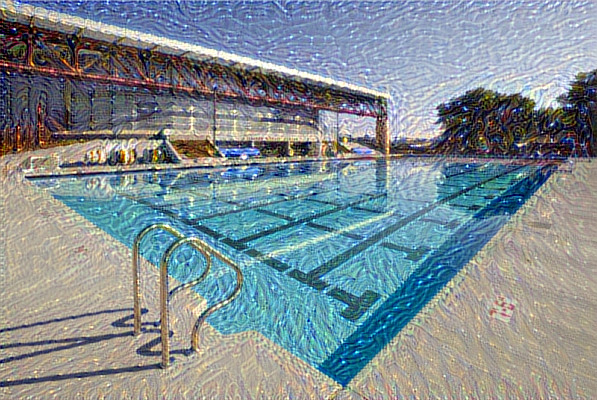

Iteration 1


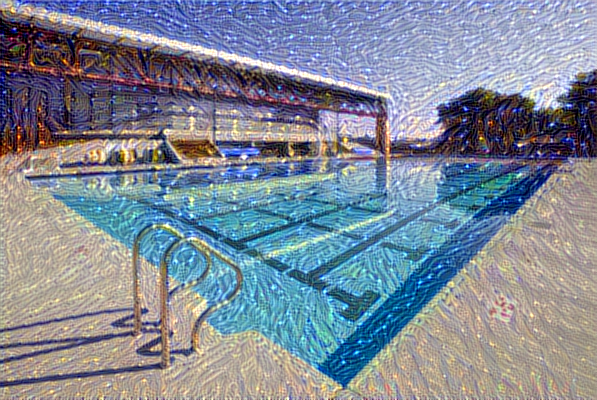

Iteration 2


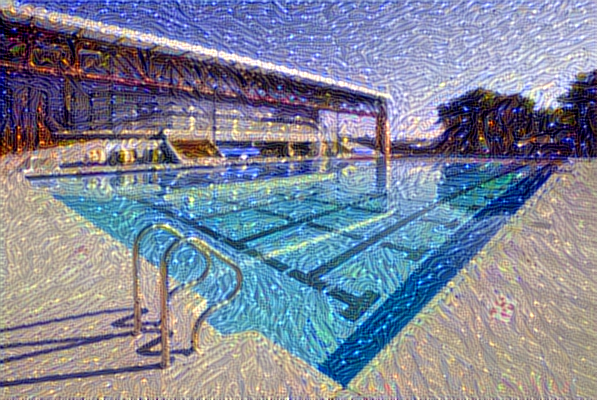

Iteration 3


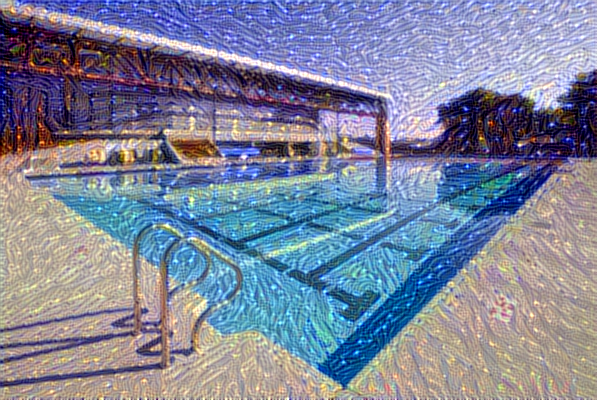

Iteration 4


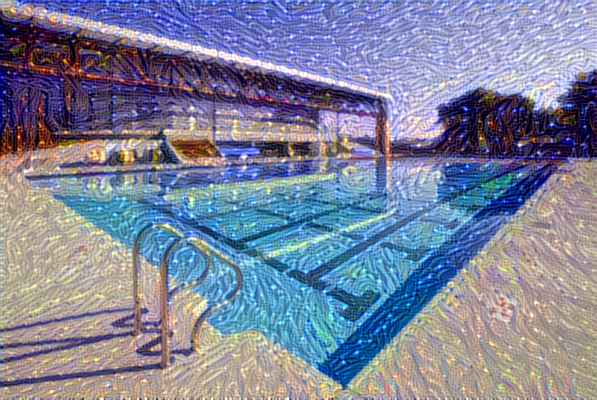

Iteration 5


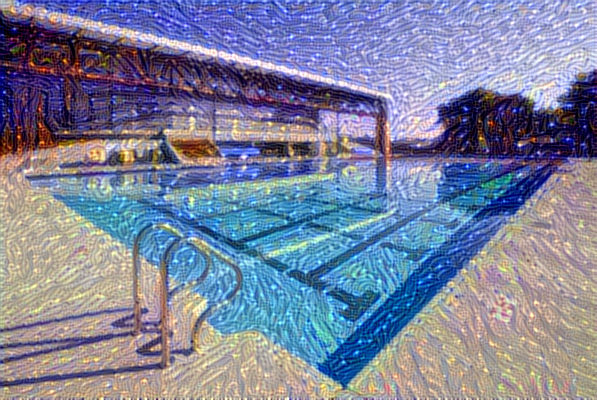

Iteration 6


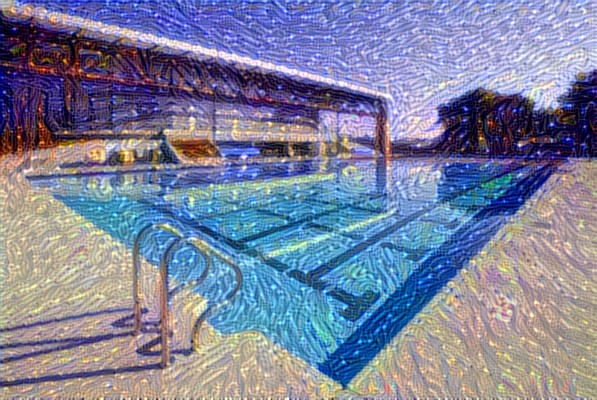

Iteration 7


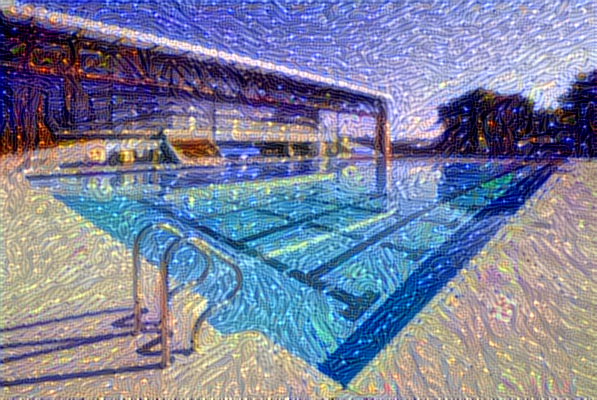

Iteration 8


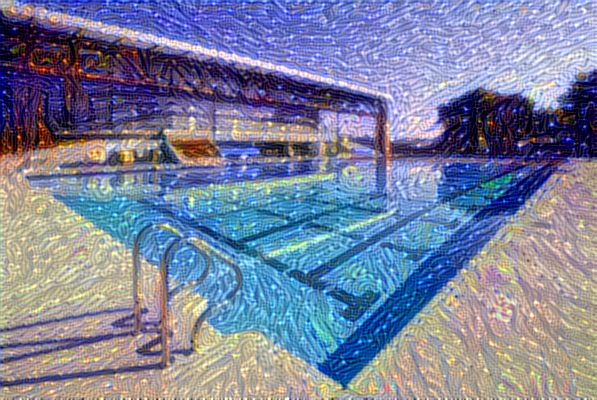

Iteration 9


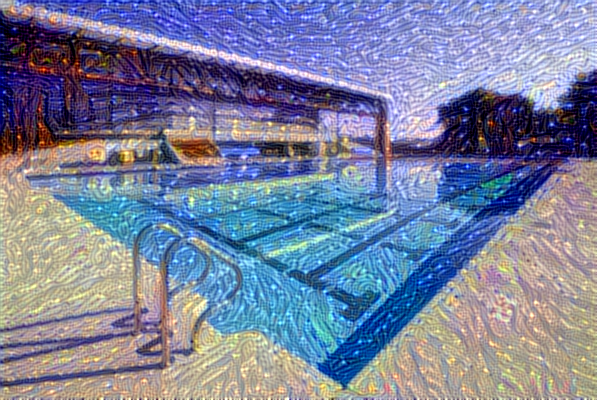

In [12]:
!ls 

for i in range(10):
  image = IMG.open("result_at_iteration_" + str(i) + ".png")
  #Image details
  if not i:
    print("format:", image.format)
    print("mode:", image.mode)
    print("size:", image.size)
  print ("Iteration", i)
  display(Image(filename="result_at_iteration_" + str(i) + ".png"))

Upload reference image


Saving hypnoticrainbowswirls.jpg to hypnoticrainbowswirls.jpg
Base image:


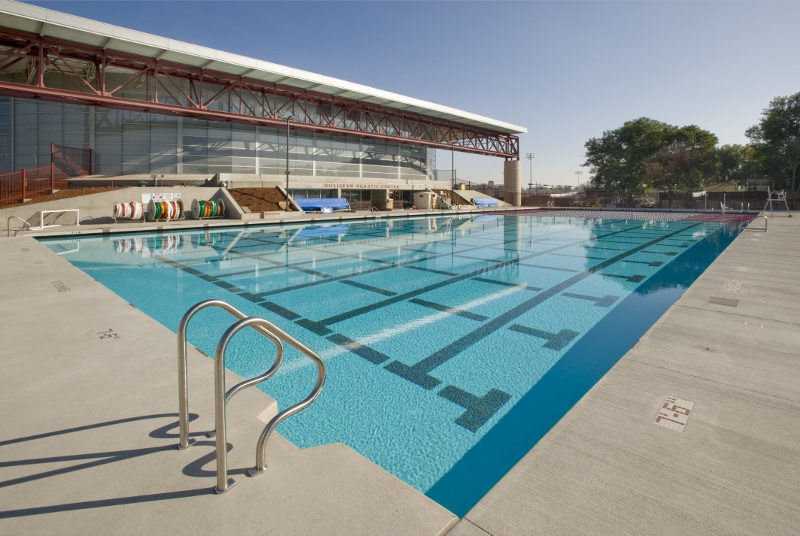


Ref image:


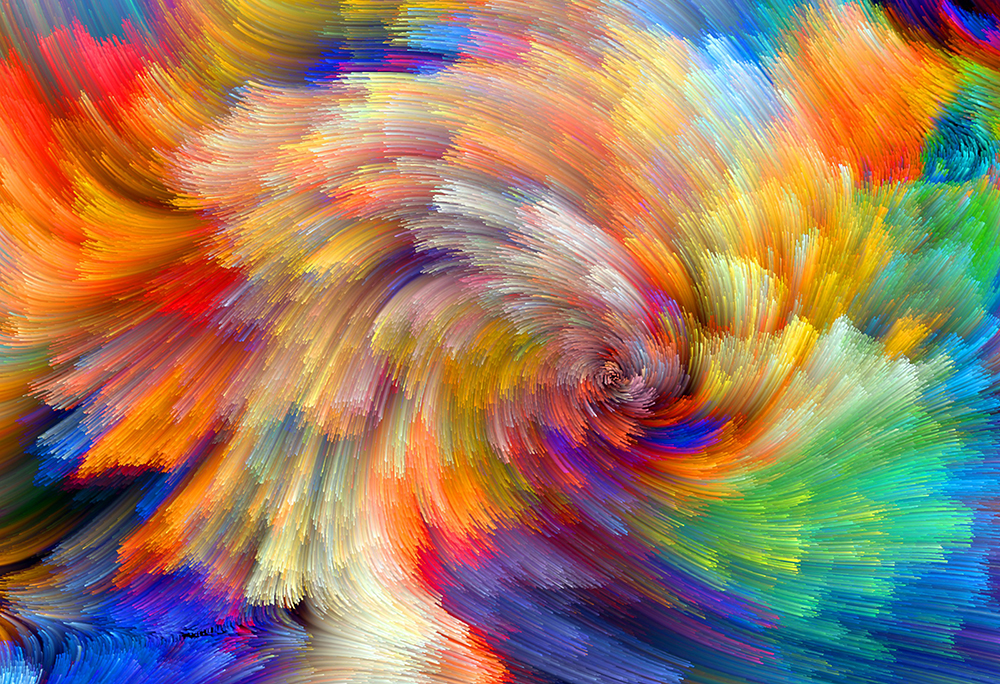

Using TensorFlow backend.







2020-03-02 02:00:24.734420: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX512F
2020-03-02 02:00:24.740102: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2000134999 Hz
2020-03-02 02:00:24.740433: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x6178e00 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-03-02 02:00:24.740482: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version
2020-03-02 02:00:24.742468: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-03-02 02:00:24.883887: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:983] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2

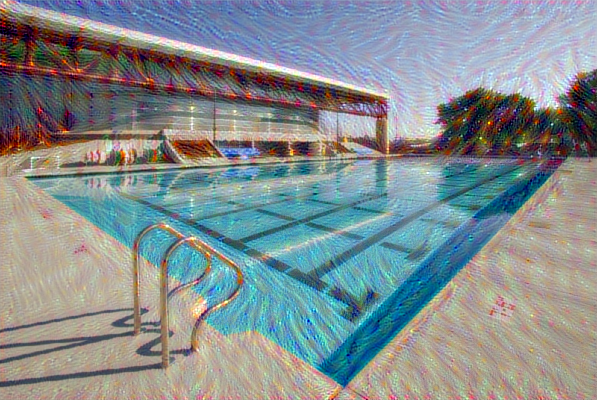

Iteration 1


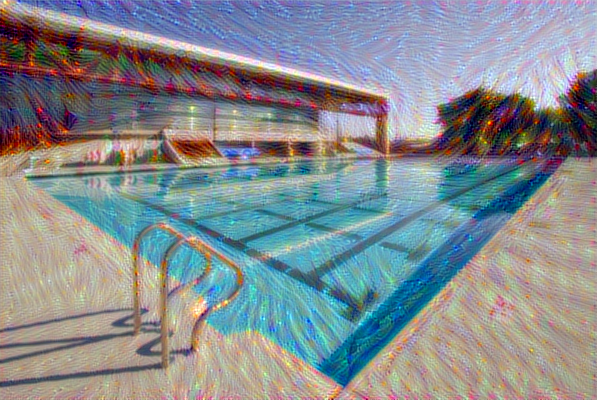

Iteration 2


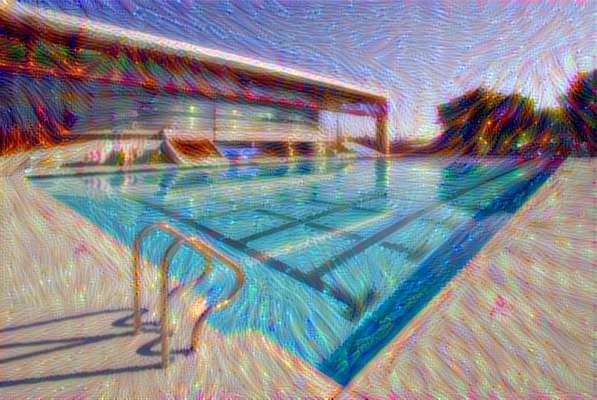

Iteration 3


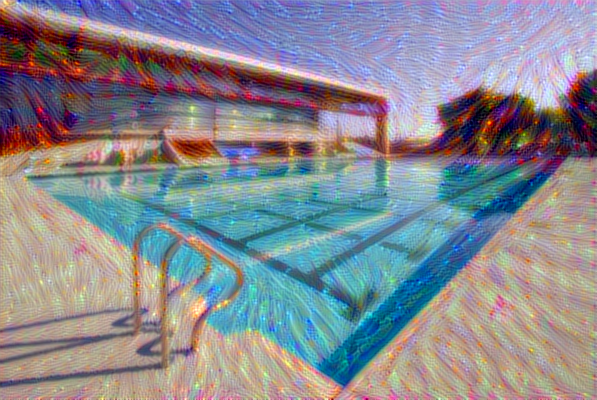

Iteration 4


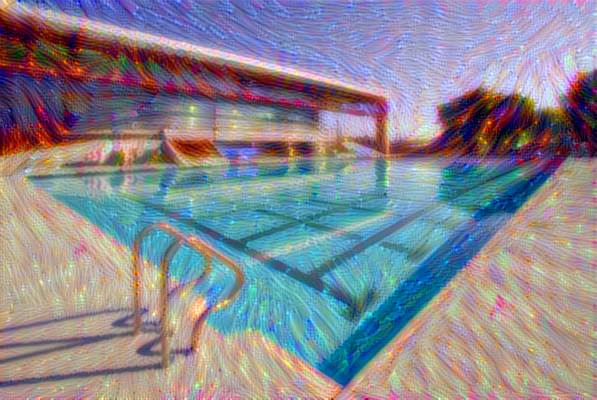

Iteration 5


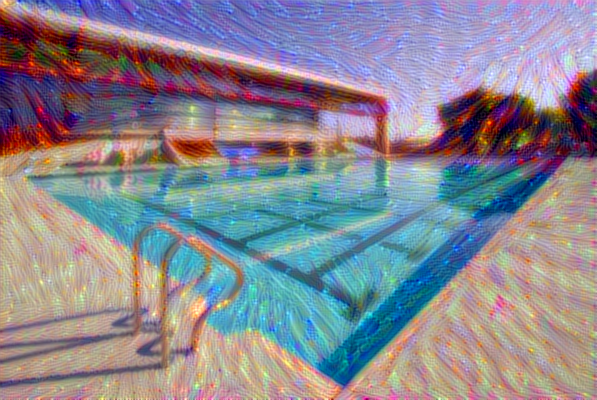

Iteration 6


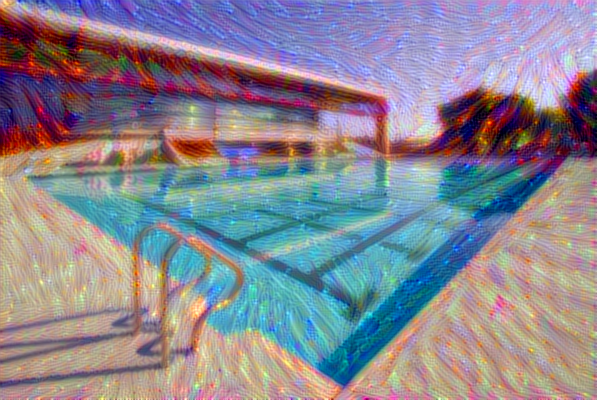

Iteration 7


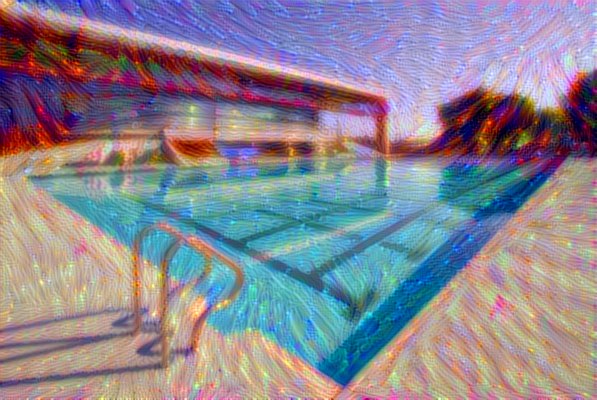

Iteration 8


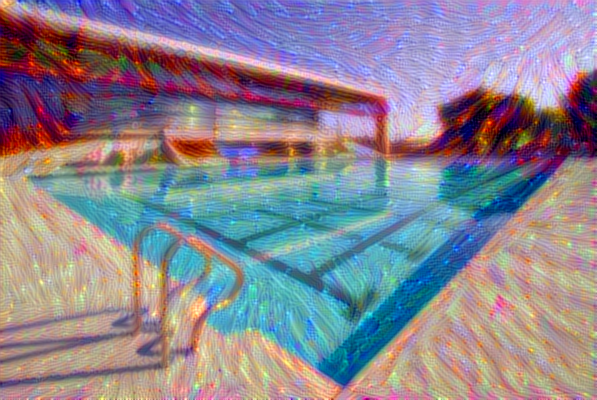

Iteration 9


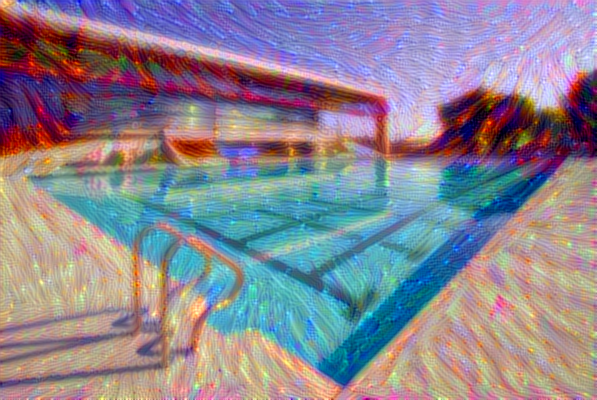

In [13]:
print ("Upload reference image")
ref = files.upload()

filebase, fileref = next(iter(base)), next(iter(ref))

#Show base and ref image
print ("Base image:")
display(Image(filename=filebase))

print()
print("Ref image:")
display(Image(filename=fileref))

!python keras/examples/neural_style_transfer.py $filebase $fileref result

for i in range(10):
  image = IMG.open("result_at_iteration_" + str(i) + ".png")
  #Image details
  if not i:
    print("format:", image.format)
    print("mode:", image.mode)
    print("size:", image.size)
  print ("Iteration", i)
  display(Image(filename="result_at_iteration_" + str(i) + ".png"))

Upload base image:


Saving Mission-and-Fountain-at-Night.jpg to Mission-and-Fountain-at-Night.jpg
Upload reference image


Saving hypnoticrainbowswirls.jpg to hypnoticrainbowswirls (1).jpg
Base image:


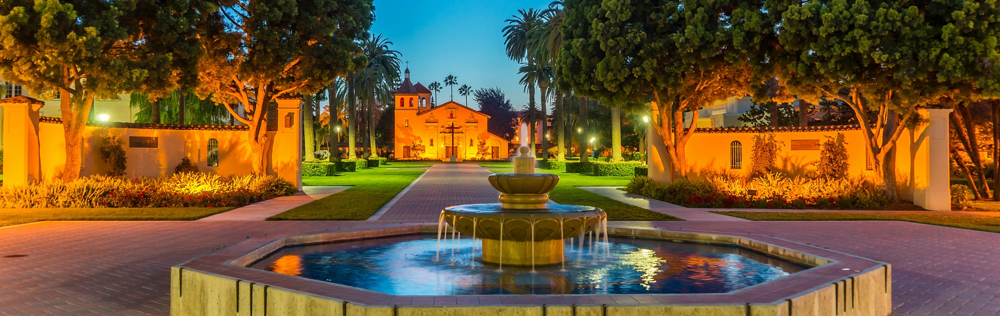


Ref image:


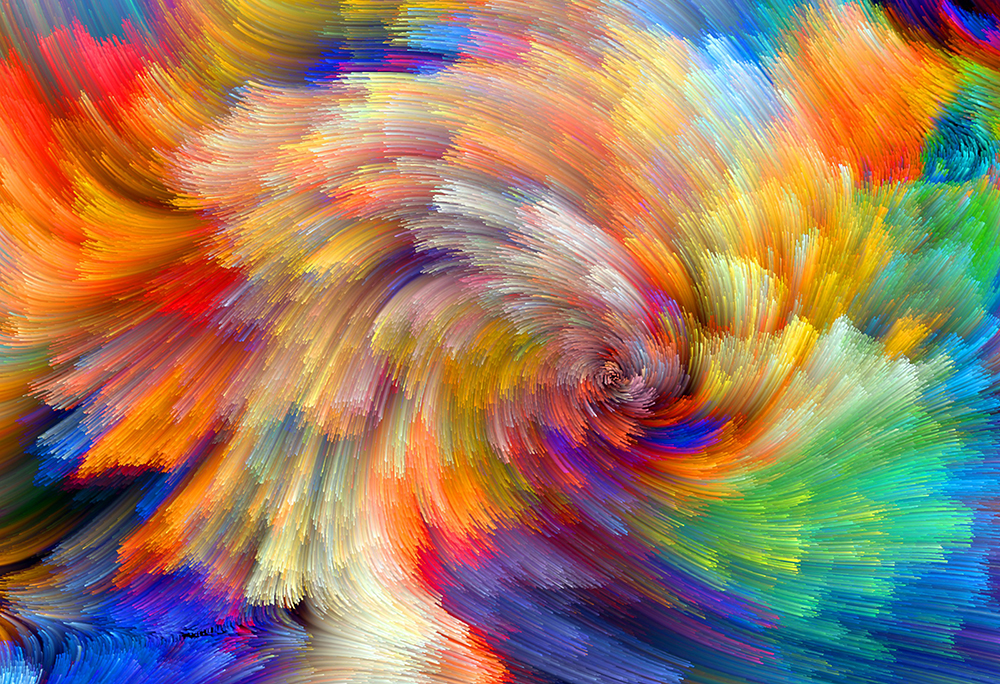

Using TensorFlow backend.







2020-03-02 02:06:57.811506: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX512F
2020-03-02 02:06:57.816290: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2000134999 Hz
2020-03-02 02:06:57.816544: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x44c0e00 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-03-02 02:06:57.816587: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version
2020-03-02 02:06:57.818779: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-03-02 02:06:57.969438: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:983] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2

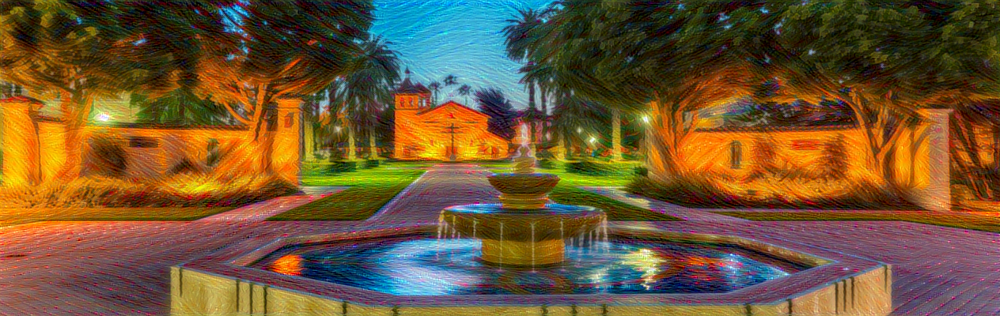

Iteration 1


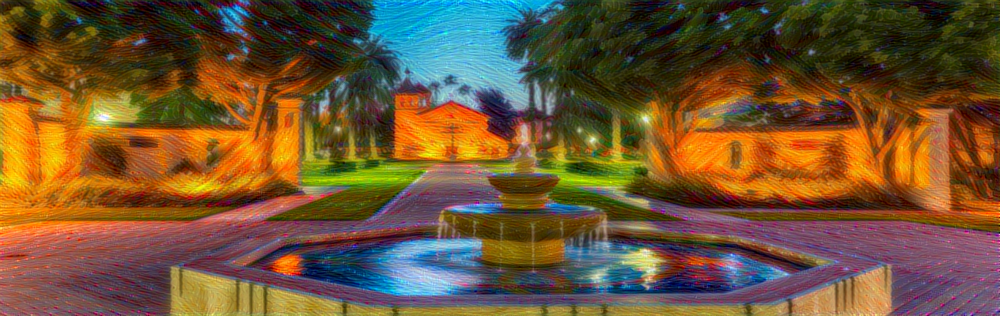

Iteration 2


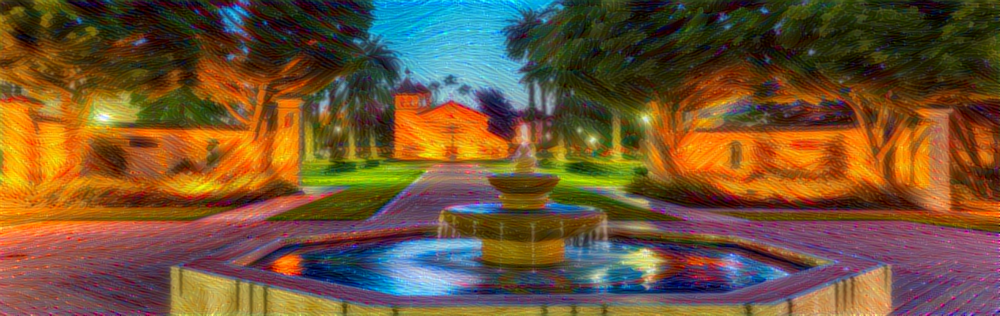

Iteration 3


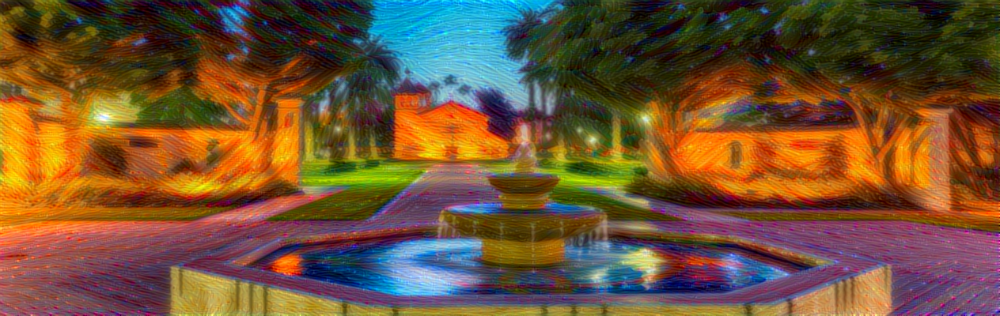

Iteration 4


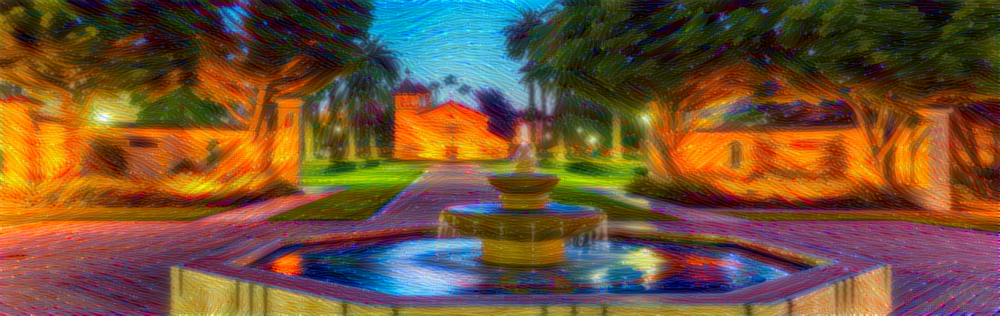

Iteration 5


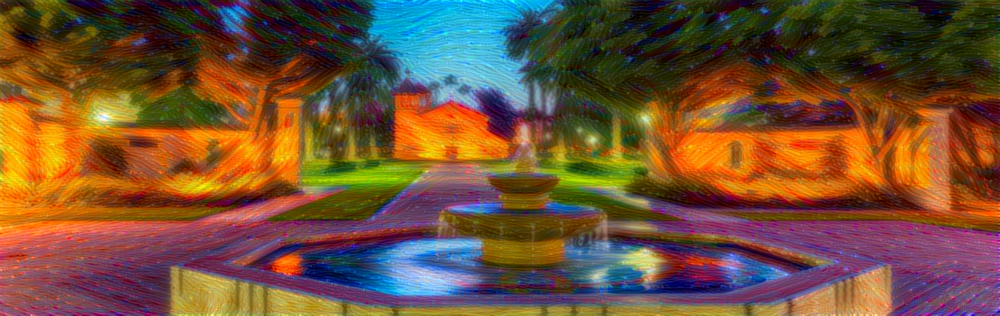

Iteration 6


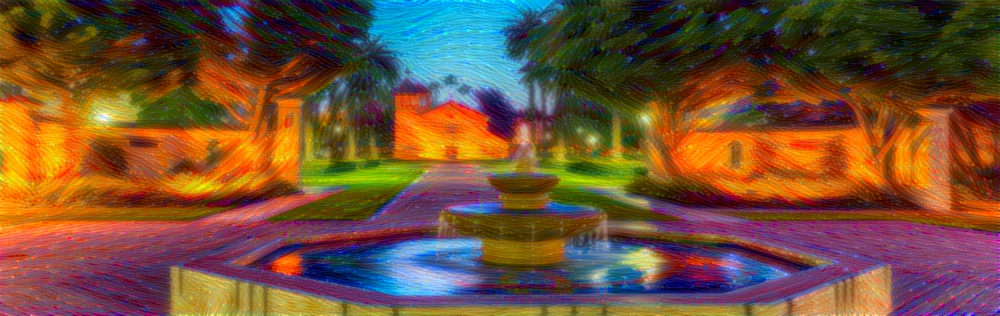

Iteration 7


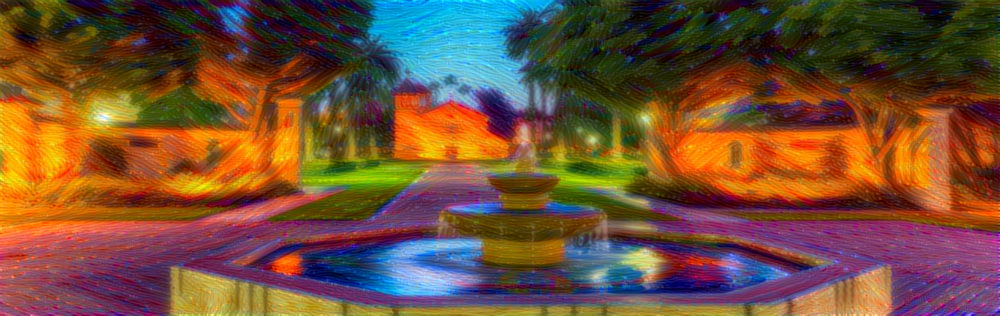

Iteration 8


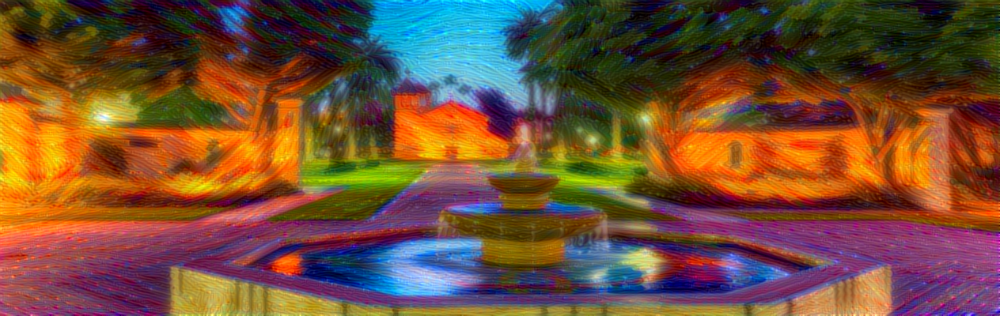

Iteration 9


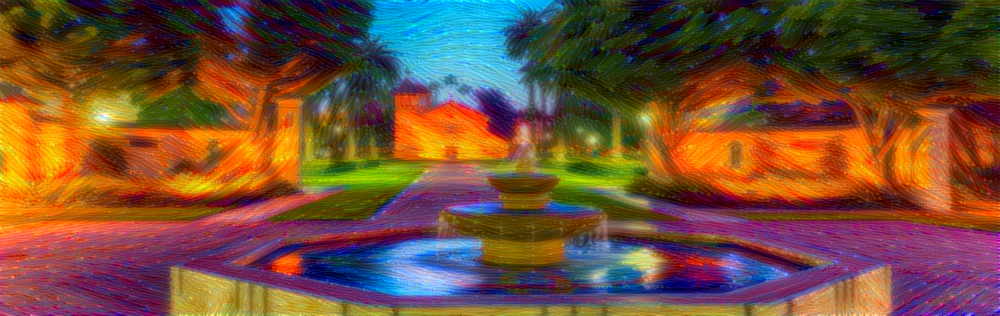

In [14]:
print ("Upload base image:")
base = files.upload()
print ("Upload reference image")
ref = files.upload()

filebase, fileref = next(iter(base)), next(iter(ref))

#Show base and ref image
print ("Base image:")
display(Image(filename=filebase))

print()
print("Ref image:")
display(Image(filename=fileref))

!python keras/examples/neural_style_transfer.py $filebase $fileref result

for i in range(10):
  image = IMG.open("result_at_iteration_" + str(i) + ".png")
  #Image details
  if not i:
    print("format:", image.format)
    print("mode:", image.mode)
    print("size:", image.size)
  print ("Iteration", i)
  display(Image(filename="result_at_iteration_" + str(i) + ".png"))